# Assignment 1 — Digital Image Processing

**Goal.** Implementing the required filters/transforms(i.e, smoothing, edge detection, sahrpening, histogram matching, steganography, and HDR imaging) from scratch, running them on the given images, and writing observations on what the outputs actually show.

**Folder layout I’m using**
```bash
src/
  main.ipynb  #Code, results, and written answers
images/
  q1/         #images chosen for spatial filtering
  q2/         #provided source and target images
  q3/         #provided stego image
  q4/         #provided low/medium/high exposure images
  outputs/    #figures saved directly from the notebook
README.md
```

**Q1 (Spatial Filtering)**. I’m using two different images for Q1 — one grainy (to test noise reductions) and one edgy (to test edge preservation) — so it’s easy to see where mean vs. Gaussian filters, or sharpening methods, perform better.

**Q2 (Histogram Matching)**. The given source and target images are used to manually implement histogram, CDF, and matching functions.

**Q3 (Steganography)**. The provided stego image is analyzed via bit-plane slicing, followed by custom encryption/decryption functions.

**Q4 (HDR Imaging)**. The provided low, medium, and high exposure images are merged into a single HDR image and tone-mapped for visualization

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import os

#to save all figures for better visualization
OUTPUT_DIR = "../images/outputs"
os.makedirs(OUTPUT_DIR, exist_ok=True)

#read image in grayscale (float32 array, values 0-255)
def imread_gray(path):
    return np.array(Image.open(path).convert('L'), dtype=np.float32)

#read image in RGB colors (float32 array, values 0-255)
def imread_color(path):
    return np.array(Image.open(path).convert('RGB'), dtype=np.float32)

#to display multiple images in a singel row
def show_imgs_row(imgs, titles=None, figsize=(15,5), save_path=None):
    n = len(imgs)
    fig = plt.figure(figsize=figsize)
    for i,im in enumerate(imgs):
        ax = plt.subplot(1,n,i+1)
        if im.ndim==2:
            ax.imshow(im, cmap='gray', vmin=0, vmax=255)
        else:
            ax.imshow(np.clip(im/255.0, 0, 1))
        ax.axis('off')
        if titles: ax.set_title(titles[i])
    plt.tight_layout()
    if save_path:
        fig.savefig(save_path, dpi=160, bbox_inches='tight')
    plt.show()

## Q1. Spatial Filtering (grainy & edgy)

**What I did.** 
Manual convolution, mean & Gaussian smoothing, Prewitt/Sobel/Laplacian edges, and sharpening (unsharp + high‑boost). I am applying everything to both images (grainy and edgy image).

In [2]:
#convolution helpers
def pad_reflect(img, k):
    #pad image with reflection to handleborder effects
    pad = k//2
    if img.ndim==2: #grayscale
        return np.pad(img, ((pad,pad),(pad,pad)), mode='reflect')
    else: # color i.e., 3 channels
        return np.pad(img, ((pad,pad),(pad,pad),(0,0)), mode='reflect')

def conv2d_gray(img, kernel):
    #2D convolution for grayscale images
    k = kernel.shape[0]
    H, W = img.shape
    img_p = pad_reflect(img, k)
    out = np.zeros((H, W), dtype=np.float32)
    for i in range(H):
        for j in range(W):
            out[i,j] = np.sum(img_p[i:i+k, j:j+k] * kernel)
    return out

def conv2d_color(img, kernel):
    #applying convolution channel-wise for RGB images
    out = np.zeros_like(img, dtype=np.float32)
    for c in range(3):
        out[...,c] = conv2d_gray(img[...,c], kernel)
    return out

#smoothing
def mean_filter(img, k=3):
    #mean or average filter with kernel size k
    kernel = np.ones((k,k), dtype=np.float32) / (k*k)
    return conv2d_gray(img, kernel) if img.ndim==2 else conv2d_color(img, kernel)

def gaussian_kernel(k=5, sigma=1.0):
    #generating normalized gaussian kernel
    ax = np.arange(-(k//2), k//2+1)
    xx, yy = np.meshgrid(ax, ax)
    g = np.exp(-(xx**2 + yy**2) / (2*sigma**2))
    g /= np.sum(g)
    return g.astype(np.float32)

def gaussian_filter(img, k=5, sigma=1.0):
    #gaussian smoothing filter
    gk = gaussian_kernel(k, sigma)
    return conv2d_gray(img, gk) if img.ndim==2 else conv2d_color(img, gk)

#edge detectors
PREWITT_X = np.array([[-1,0,1],[-1,0,1],[-1,0,1]], dtype=np.float32)
PREWITT_Y = np.array([[1,1,1],[0,0,0],[-1,-1,-1]], dtype=np.float32)
SOBEL_X   = np.array([[-1,0,1],[-2,0,2],[-1,0,1]], dtype=np.float32)
SOBEL_Y   = np.array([[1,2,1],[0,0,0],[-1,-2,-1]], dtype=np.float32)
LAPL      = np.array([[0,1,0],[1,-4,1],[0,1,0]],  dtype=np.float32)  # 4-neighbor

def prewitt_edges(g):
    #prewitt edge detection (gradient magnitude)
    gx, gy = conv2d_gray(g, PREWITT_X), conv2d_gray(g, PREWITT_Y)
    mag = np.hypot(gx, gy); mag = (mag / (mag.max()+1e-6)) * 255
    return mag

def sobel_edges(g):
    #sobel edge detection (gradient magnitude)
    gx, gy = conv2d_gray(g, SOBEL_X), conv2d_gray(g, SOBEL_Y)
    mag = np.hypot(gx, gy); mag = (mag / (mag.max()+1e-6)) * 255
    return mag

def laplacian_edges(g):
    #laplacian edge detection (second derivative)
    lg = np.abs(conv2d_gray(g, LAPL))
    lg = (lg / (lg.max()+1e-6)) * 255
    return lg

#sharpening
def laplacian(g): 
    #applying laplacian operator
    return conv2d_gray(g, LAPL)

def unsharp_masking(g):
    #unsharp masking = original + Laplacian
    return np.clip(g + laplacian(g), 0, 255)

def highboost(g, a=1.0, k=5, sigma=1.0):
    #high-boost filtering = original + a*(original - blurred)
    blur = gaussian_filter(g, k, sigma)
    mask = g - blur
    return np.clip(g + a*mask, 0, 255)

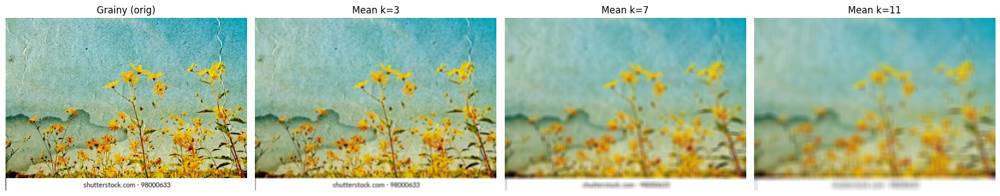

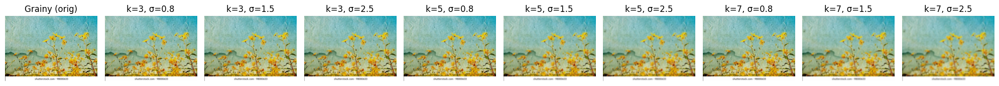

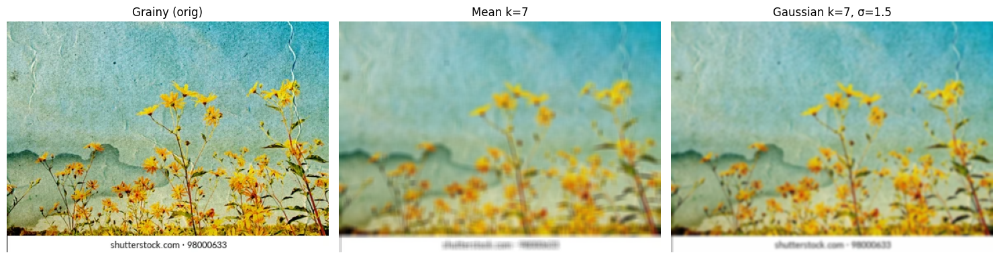

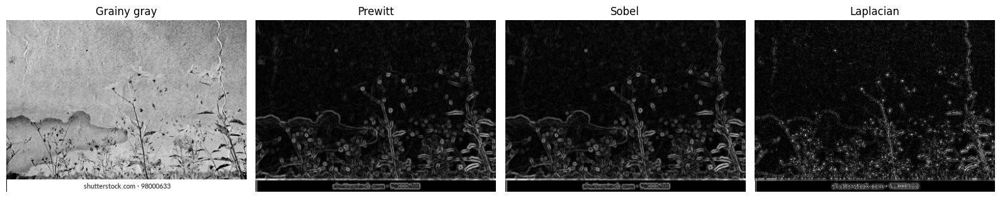

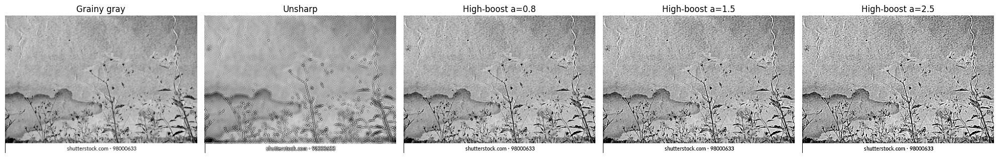

...

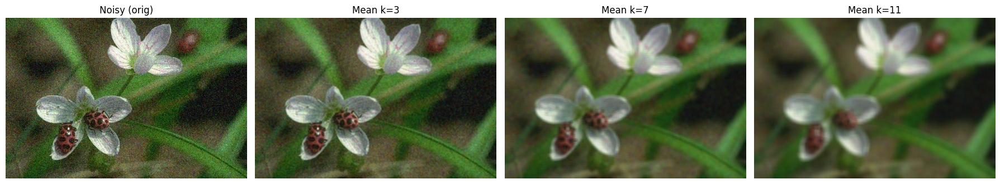

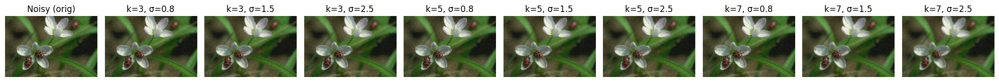

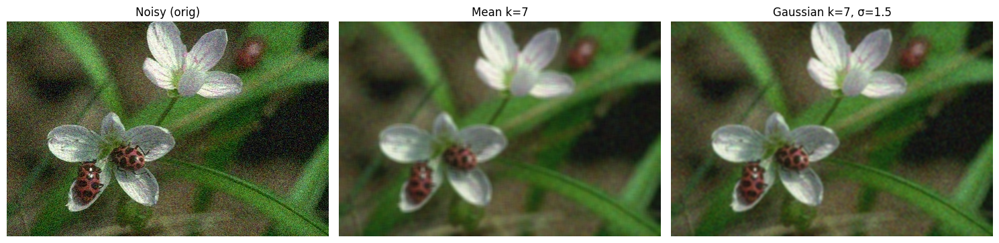

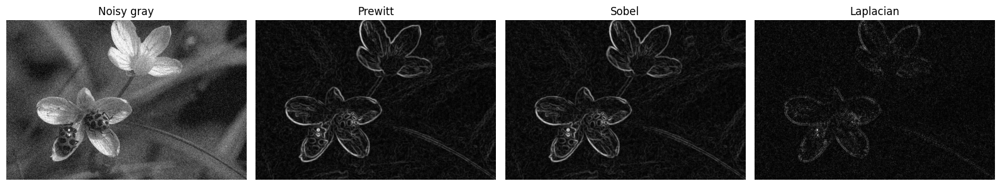

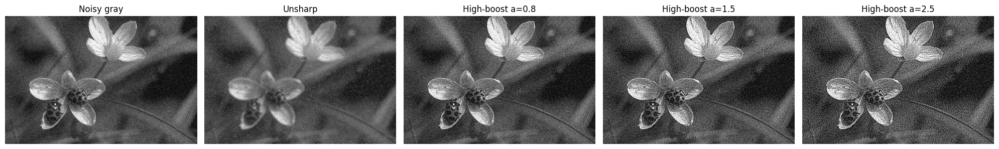

In [3]:
grainy = '../images/q1/grainyPic.webp'
edgy   = '../images/q1/edgyPic.jpeg'
noisy = '../images/q1/noisyPic.webp'

for label, path in [('Grainy', grainy), ('Edgy', edgy), ('Noisy', noisy)]:
    if not os.path.exists(path):
        print("Missing:", path); 
        continue

    #read images in color and grayscale
    img_c = imread_color(path); g = imread_gray(path)

    #smoothing: Mean vs Gaussian
    #mean: k=3,7,11 (comparing mean filter with increasing kernel sizes)
    show_imgs_row(
        [img_c, mean_filter(img_c,3), mean_filter(img_c,7), mean_filter(img_c,11)],
        [f"{label} (orig)", "Mean k=3", "Mean k=7", "Mean k=11"],
        figsize=(18,4), save_path=os.path.join(OUTPUT_DIR, f"q1_{label.lower()}_mean.png")
    )

    #gaussian smoothing filter: 3×3 grid
    #trying different kernel sizes and σ values
    ks = [3,5,7]
    sigmas = [0.8, 1.5, 2.5]
    grid, titles = [], []
    for k in ks:
        for s in sigmas:
            grid.append(gaussian_filter(img_c, k, s))
            titles.append(f"k={k}, σ={s}")
    show_imgs_row([img_c]+grid, [f"{label} (orig)"]+titles, figsize=(20,8),
                save_path=os.path.join(OUTPUT_DIR, f"q1_{label.lower()}_gaussian.png"))

    #comparison: mean vs Gaussian
    m7 = mean_filter(img_c,7)
    g7 = gaussian_filter(img_c,7,1.5)
    show_imgs_row([img_c, m7, g7],
                [f"{label} (orig)", "Mean k=7", "Gaussian k=7, σ=1.5"],
                figsize=(15,4), save_path=os.path.join(OUTPUT_DIR, f"q1_{label.lower()}_compare.png"))

    #edges detection (with light denoising first)
    g_s = gaussian_filter(g, 5, 1.0)
    show_imgs_row(
        [g, prewitt_edges(g_s), sobel_edges(g_s), laplacian_edges(g_s)],
        [f"{label} gray", "Prewitt", "Sobel", "Laplacian"],
        figsize=(16,4), save_path=os.path.join(OUTPUT_DIR, f"q1_{label.lower()}_edges.png")
    )

    #sharpening
    #comparing unsharp masking vs high-boost with different weights
    show_imgs_row(
        [g, unsharp_masking(g), highboost(g,0.8,5,1.2), highboost(g,1.5,5,1.2), highboost(g,2.5,5,1.2)],
        [f"{label} gray", "Unsharp", "High-boost a=0.8", "High-boost a=1.5", "High-boost a=2.5"],
        figsize=(20,4), save_path=os.path.join(OUTPUT_DIR, f"q1_{label.lower()}_sharpen.png")   
    )


### Q1 — Observations
- **Smoothing (Mean vs Gaussian):**
    - For the grainy image we used, mean filtering with larger kernels (7,11) suppressed random noise, but blurred edges a lot.
    - Gaussian filtering reduces noise while retaining edge definition better at the same kernel  size. With larger σ values, Gaussian still blurs but keeps contours cleaner than mean.
    - For our edgy image, mean filtering tends to smear edges, while Gaussian with a moderate σ (≈1.0–1.5) gives a smoother result without destroying the edge sharpness.
- **Comparision:**
    - ***Grainy image***: Mean filter outperforms Gaussian for noise suppression because it averages uniformly across the neighborhood.
    - ***Edgy image***: Gaussian filter outperforms mean because distance-weighted averaging preserves edge structures better.
- **Edge Detection:**
    - ***Prewitt***: simple, highlights broad edgees but less sensitive.
    - ***Sobel***: stronger weighting which leads to clearer outlines, better for detecting directional edges.
    - ***Laplacian***: captures fine detail and sharp transitions, but also amplifies noise; works best after slight Gaussian smoothing.
- **Sharpening:** 
    - ***Unsharp masking***: adds detail cleanly by reinforcing high-frequency content.
    - ***High-boost filtering***: 
        - At ***a=0.8***, edges are enchanced moderately leading to a natural, punchy look.
        - At ***a=1.5***, edges are strongly enhanced making visible halos appear.
        - At ***a=2.5***, sharpening is aggressive giving a more artificial look, halos and noise are amplified.

## Q2. Histogram Matching (manual)

**What I did.** 
Implemented histogram matching completely from scratch:
- ***Histogram computation***: wrote a function to count pixel intensities for each channel.
- ***CDF calculation***: derived the cumulative distribution to serve as the mapping backbone.
- ***Channel-wise mapping***: matched each source channel to the corresponding target channel by aligning their CDFs.
- ***Verification***: test the implementation on:
    - Source to Target matching (our main task at hand)
    - Self-matching (should reproduce the same image, proving correctness of our code).
    - Synthetic bright/dark pairs (to study how tone transfer affects contrast and noise).
    - Equalization vs matching to equalized (to compare direct histogram stretching against mapping to a uniform distribution).

In [4]:
#histogram helper functions
#computing histogram (0-255) for a single channel image
def compute_histogram(ch):
    hist = np.zeros(256, dtype=np.float64)
    vals = ch.astype(np.int32).flatten()
    for v in vals: hist[v] += 1
    return hist

#computing normalized CDF
def compute_cdf(hist):
    c = np.cumsum(hist)
    return c / (c[-1] + 1e-12)

#histogram matching i.e., matching source channel histogram to target channel
def match_channel(src, tgt):
    cs, ct = compute_cdf(compute_histogram(src)), compute_cdf(compute_histogram(tgt))
    mapping = np.zeros(256, dtype=np.uint8)
    j = 0
    #finding closeest CDF value in target for each of the intensities in our source
    for i in range(256):
        while j < 255 and ct[j] < cs[i]:
            j += 1
        mapping[i] = j
    #and then applying mapping...
    flat = src.astype(np.int32).flatten()
    out  = np.array([mapping[v] for v in flat], dtype=np.uint8).reshape(src.shape)
    return out.astype(np.float32)

#applying g=histogram matching per channel for RGB images
def match_color_image(src, tgt):
    out = np.zeros_like(src, dtype=np.float32)
    for c in range(3):
        out[...,c] = match_channel(src[...,c], tgt[...,c])
    return out

#for visualization of RGB histograms of an image
def plot_hist_rgb(img, title="Histogram (RGB)", save_path=None):
    fig, ax = plt.subplots(figsize=(6,3))
    labs=['R','G','B']
    for c in range(3):
        h = compute_histogram(img[...,c])
        ax.plot(h, label=labs[c])
    ax.set_title(title); ax.legend(); plt.tight_layout()
    if save_path: fig.savefig(save_path, dpi=160, bbox_inches='tight')
    plt.show()

#histogram equalization
#for a single channel
def equalize_channel(ch):
    h = compute_histogram(ch)
    c = compute_cdf(h)
    mapping = np.floor(255*c).astype(np.uint8)
    flat = ch.astype(np.int32).flatten()
    out  = np.array([mapping[v] for v in flat], dtype=np.uint8).reshape(ch.shape)
    return out.astype(np.float32)
#equalizing each channel of an RGB image serperately
def equalize_color(img):
    out = np.zeros_like(img, dtype=np.float32)
    for c in range(3):
        out[...,c] = equalize_channel(img[...,c])
    return out

#scaling brightness by a factor and clipping to [0,255] for brightness adjustment
def adjust_brightness(img, factor):
    return np.clip(img * factor, 0, 255).astype(np.float32)

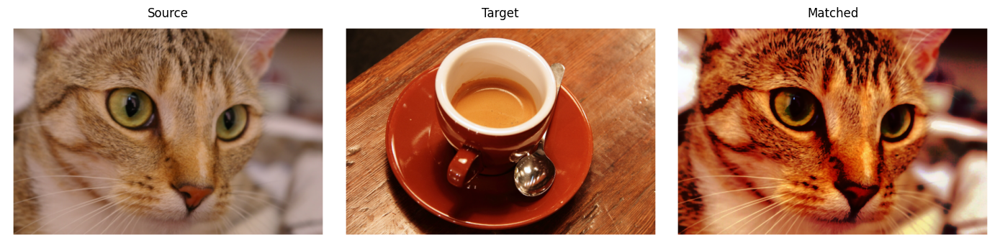

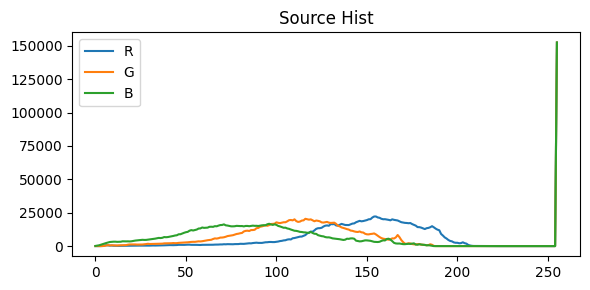

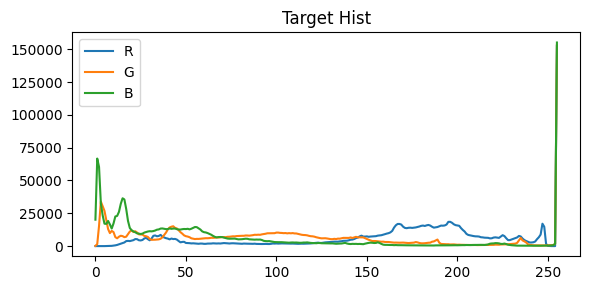

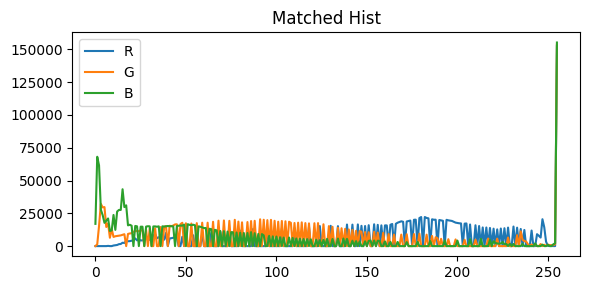

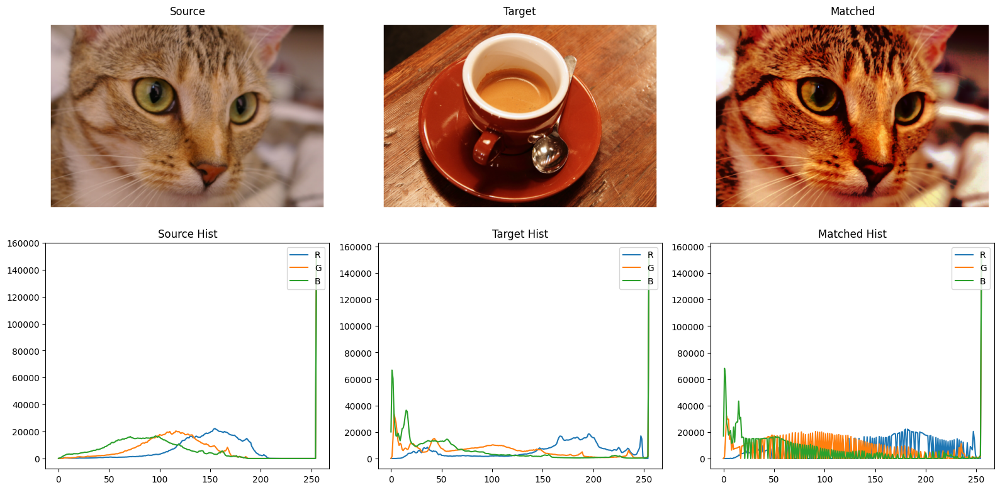

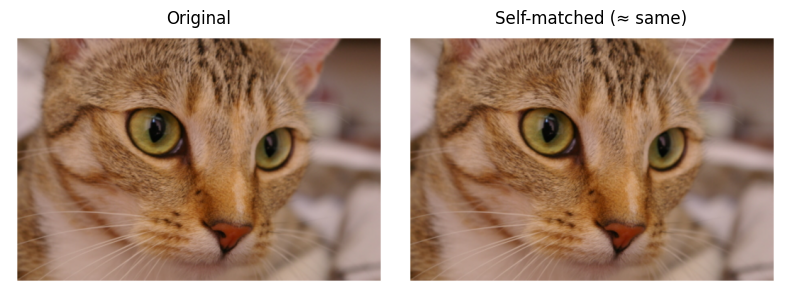

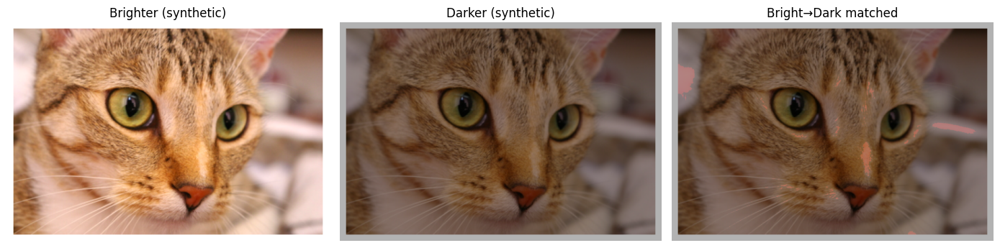

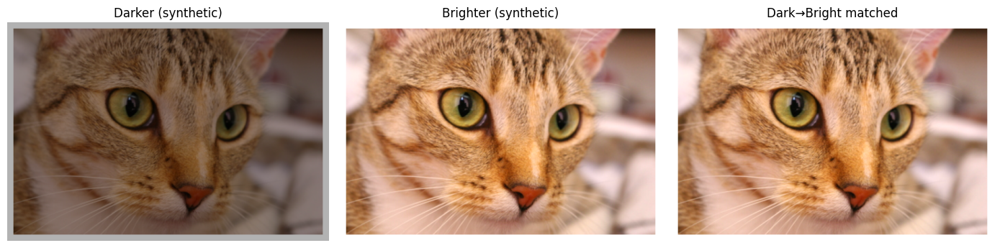

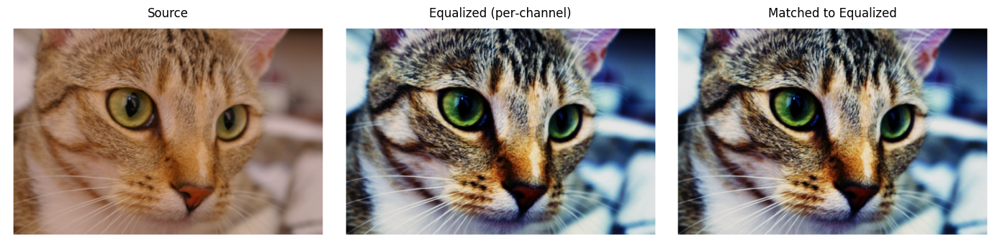

In [5]:
src_path = '../images/q2/source_image.png'
tgt_path = '../images/q2/target_image.png'

if not (os.path.exists(src_path) and os.path.exists(tgt_path)):
    print("Place source_image.png and target_image.png in images/q2/.")
else:
    #loading input images
    src = imread_color(src_path).astype(np.float32)
    tgt = imread_color(tgt_path).astype(np.float32)

    #core histogram matching
    matched = match_color_image(src, tgt)
    show_imgs_row([src, tgt, matched], ["Source", "Target", "Matched"], figsize=(14,4), save_path=os.path.join(OUTPUT_DIR, "q2_matched_triplet.png"))

    #saving RGB histograms
    plot_hist_rgb(src, "Source Hist", os.path.join(OUTPUT_DIR, "q2_hist_source.png"))
    plot_hist_rgb(tgt, "Target Hist", os.path.join(OUTPUT_DIR, "q2_hist_target.png"))
    plot_hist_rgb(matched, "Matched Hist", os.path.join(OUTPUT_DIR, "q2_hist_matched.png"))

    #2×3 figure (images on top, hists on bottom) , as required from assign spec
    fig, axes = plt.subplots(2, 3, figsize=(16, 8))

    #top row, cat images
    pairs = [
        (axes[0,0], src,     'Source'),
        (axes[0,1], tgt,     'Target'),
        (axes[0,2], matched, 'Matched')
    ]
    for ax, im, title in pairs:
        ax.imshow(np.clip(im/255.0, 0, 1))
        ax.set_title(title)
        ax.axis('off')

    def _plot_rgb_hist_on(ax, im, title):
        r = compute_histogram(im[...,0])
        g = compute_histogram(im[...,1])
        b = compute_histogram(im[...,2])
        ax.plot(r, label='R') #red channel histogram
        ax.plot(g, label='G') #green channel histogram
        ax.plot(b, label='B') #blue channel histogram
        ax.set_title(title)
        ax.legend(loc='upper right')
    
    #bottom row, RGB histograms
    _hist_pairs = [
        (axes[1,0], src,'Source Hist'),
        (axes[1,1], tgt,'Target Hist'),
        (axes[1,2], matched, 'Matched Hist')
    ]
    for ax, im, title in _hist_pairs:
        _plot_rgb_hist_on(ax, im, title)

    fig.tight_layout()
    fig.savefig(os.path.join(OUTPUT_DIR, "q2_2x3_combo.png"), dpi=160, bbox_inches='tight')
    plt.show()


    #self-matching = identity
    self_match = match_color_image(src, src)
    show_imgs_row([src, self_match], ["Original", "Self-matched (≈ same)"], figsize=(8,4), save_path=os.path.join(OUTPUT_DIR, "q2_self_match.png"))

    #bright/dark
    brighter = adjust_brightness(src, 1.3) #bright by 30%
    darker   = adjust_brightness(src, 0.7) #darken by 30%
    b2d = match_color_image(brighter, darker) #mapping bright to dark
    d2b = match_color_image(darker, brighter) #mapping dark to bright
    show_imgs_row([brighter, darker, b2d], ["Brighter (synthetic)", "Darker (synthetic)", "Bright→Dark matched"], figsize=(14,4), save_path=os.path.join(OUTPUT_DIR, "q2_bright_to_dark.png"))
    show_imgs_row([darker, brighter, d2b], ["Darker (synthetic)", "Brighter (synthetic)", "Dark→Bright matched"], figsize=(14,4), save_path=os.path.join(OUTPUT_DIR, "q2_dark_to_bright.png"))

    #equalization vs matching-to-equalized
    eq = equalize_color(src)
    matched_to_eq = match_color_image(src, eq)
    show_imgs_row([src, eq, matched_to_eq], ["Source", "Equalized (per‑channel)", "Matched to Equalized"], figsize=(14,4), save_path=os.path.join(OUTPUT_DIR, "q2_equalized_compare.png"))

### Q2 — Observations
- **Core Matching (Source to Target)**
    - The matched image successfully obtained the global brightness and color distribution of our target.
    - Global intensity distribution shifted accordingly: warm tones dominate, and brightness is lowered to match the darker coffee background.
    - The histograms show that the matched RGB channels closely approximate the target’s, though exact alignment was limited because of discrete mapping and channel-wise processing.
    - A slightly unnatural tint may appear since per-channel mapping ignores cross-channel correlations (e.g., coffee has less green than the cat).
- **Self-Match**
    - As expected, matching an image to itself yields almost no change (identity transform). This validates the correctness of our mapping code though.
- **Synthetic Bright vs Dark Matching**
    - When mapping bright to dark, the result mimics the overall dim lighting of the darker version (i.e., lower contrast and muted highlights)
    - When mapping dark to bright, shadows brighten but without introducing true highlight details (since it doesnt exist in the darker source)
    - This shows that histogram matching only redistributes pixel values but cannot recover lost details (duhh.), it matched intensity distributions but not actual scene information.
- **Equalization vs match‑to‑equalized:** 
    - ***Equalization*** redistributes each channel to be roughly uniform, thereby increasing contrast. Finer details in shadows and highlights become more visible, but colors can look washed out or unnatural.
    - ***Matching to equalized*** implements uniform distribution through mapping i.e., visually, it produces a similar effect, but with more consistent tone balancing across channels.
    - Both techniques boost contrast, but equalization is intrinsic (using the image’s own stats), while matching is extrinsic (forcing the image to follow another distribution).

## Q3. Steganography with Bit‑plane Slicing

**What I did.** 
To explore steganography, I first visualized all 8 bit-planes of a grayscale image to see where the perceptual information lies. Then I implemented a simple hiding pipeline:
- Secret preparation: generating a binary secret mask from the same image (blur + threshold).
- Embedding: Inserted this secret into the cover image’s chosen bit plane (default implemented in code is LSB).
- Decryption: Extracted the secret back from the specified bit plane.
- Visualization: Plotted bit-planes, the cover, secret, stego, and recovered outputs side-by-side.

This shows how information can be hidden within the lower-order bits without noticeably altering the cover.

In [9]:
#to convert an array to a 8-bit unsigned int (0-255 range)
def to_uint8(arr): return np.clip(np.round(arr), 0, 255).astype(np.uint8)

#extracting all 8 bit planes (0 is least significant bit and 7 is the most significant bit)
def bit_planes(gray_img):
    g = to_uint8(gray_img)
    return [(g >> b) & 1 for b in range(8)]  # returns list of binary masks

def visualize_bitplanes(gray_img):
    #shows all 8 bit planes side by side (mulitpled by 255 to make them visible)
    planes = bit_planes(gray_img)
    show_imgs_row([p*255 for p in planes], [f"Bit {b}" for b in range(8)], figsize=(18,4), save_path=os.path.join(OUTPUT_DIR, "q3_bitplanes.png"))

#extracting 8 bit planes from each RGB channel of a color image
#returns dict: { 'R': [planes], 'G': [planes], 'B': [planes] }
def bit_planes_color(color_img):
    planes_dict = {}
    for c, name in enumerate(['R','G','B']):
        channel = to_uint8(color_img[:,:,c])
        planes = [(channel >> b) & 1 for b in range(8)]
        planes_dict[name] = planes
    return planes_dict

def visualize_bitplanes_color(color_img):
    planes_dict = bit_planes_color(color_img)
    for name, planes in planes_dict.items():
        show_imgs_row([p*255 for p in planes],
                      [f"{name} Bit {b}" for b in range(8)],
                      figsize=(18,4),
                      save_path=os.path.join(OUTPUT_DIR, f"q3_bitplanes__color_{name}.png"))


#embeding a secret binary image into a chosen bit plan of the cover image
def encrypt(cover_gray, secret_bin, bit_index=0):
    cv = to_uint8(cover_gray) #cover image as uint8
    sb = (secret_bin > 0).astype(np.uint8) # ensure binary secert, 0 or 1
    mask = ~(1<<bit_index) & 0xFF #mask to clear target bit
    return (cv & mask) | (sb << bit_index) # insert the secret bit into cover

#extracting secret from chosen bit plane of a stego image
def decrypt(stego_gray, bit_index=0):
    sg = to_uint8(stego_gray)
    return ((sg >> bit_index) & 1) * 255 #recover binary image (0/255)

def decrypt_color(stego_color, channel='R', bit_index=0):
    c_idx = {'R':0,'G':1,'B':2}[channel]
    sg = to_uint8(stego_color[:,:,c_idx])
    return ((sg >> bit_index) & 1) * 255

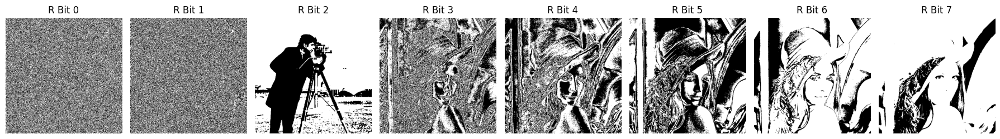

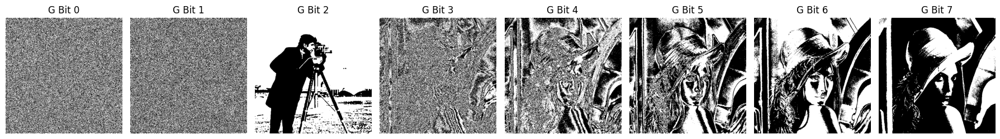

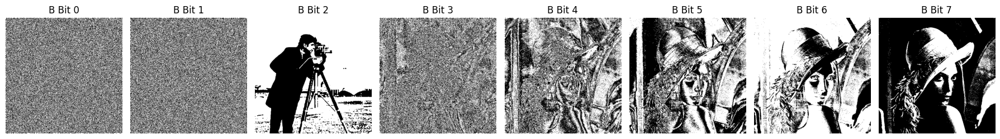

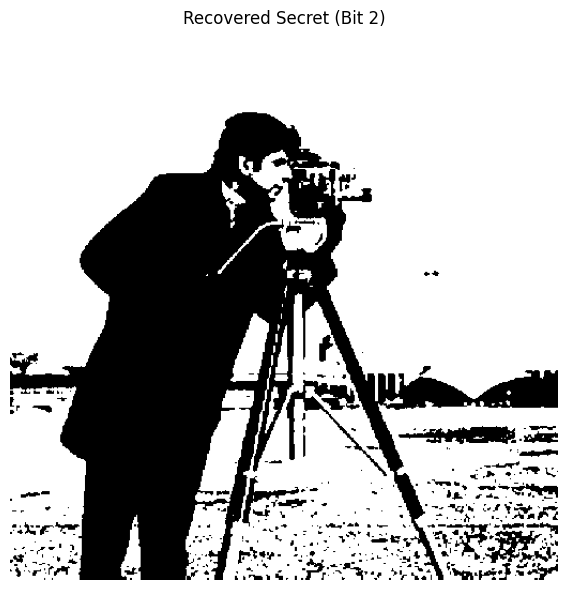

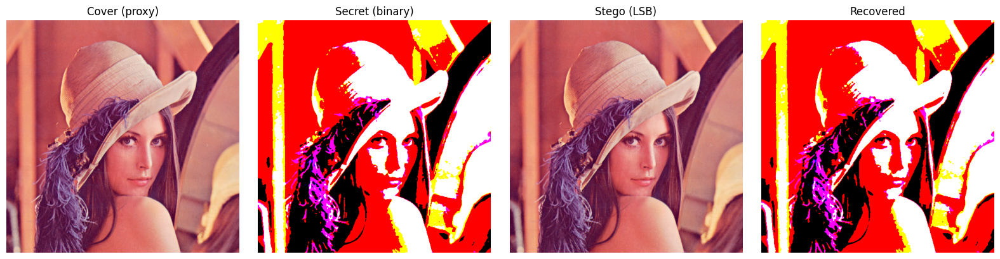

In [11]:
stego_path = '../images/q3/encrypted_image.png'
if not os.path.exists(stego_path):
    #image missing?? sos
    print("Place encrypted_image.png in images/q3/.")
else:
    #sg = imread_gray(stego_path)
    sg = imread_color(stego_path)
    #visualizinf bit planes of the given stego image
    #visualize_bitplanes(sg)  # check which plane carries structure

    visualize_bitplanes_color(sg)

    #secret hidden in bit 2
    secret_recovered = decrypt_color(sg, channel='R', bit_index=2)
    show_imgs_row([secret_recovered],
                  ["Recovered Secret (Bit 2)"],
                  figsize=(6,6),
                  save_path=os.path.join(OUTPUT_DIR, "q3_recovered_secret.png"))

    #for demo, reusing same image as cover and generating a binary "secret"
    # then smoothing the cover and threshold around the median to binary pattern
    cover = sg
    secret_soft = gaussian_filter(cover, 5, 1.2)
    secret_bin  = (secret_soft > np.median(secret_soft)).astype(np.uint8)

    #embed and recover
    stego = encrypt(cover, secret_bin, bit_index=0)  #LSB embedding
    recovered = decrypt(stego, bit_index=0)
    
    #full pipeline: original cover -> secret -> stego -> recovered
    show_imgs_row([cover, secret_bin*255, stego, recovered],
                  ["Cover (proxy)", "Secret (binary)", "Stego (LSB)", "Recovered"],
                  figsize=(16,4), save_path=os.path.join(OUTPUT_DIR, "q3_stego_pipeline_color.png"))

### Q3 — Observations
- **Bit-planes**:
    - ***MSBs (6-7)***: clearly captures the majority of the image's structure and shading and edges etc..
    - ***Middle bits (3-5)***: still contians recognizable outlines and textures but with lesser intensity than msb.
    - ***LSBs (0-2)***: appears almost random, with little visible structure making them good carriers for secret information.
    - in our case the hidden secret ***(camera man image)*** was successfully revealed in Bit2 of the stego image.
- **Steganography (LSB embeedding)**: 
    - Embedding the binary secret in the LSB (bit 0) keeps the cover image visually identical i.e., human eyes cannot detect any change.
    - The secret can be recovered exactly since we directly replaced the least significant bits.
    - However, the LSB plane is fragile: any compression, filtering, or noise can easily lead to losing the hidden data.
- **Higher-bit embedding**:
    - Embedding into bit 1 or 2 makes the secret slightly more robust but starts introducing faint patterns in the stego image.
    - Embedding into the MSB is completely visible which then wouldn't exactly be hiding, but it could probably be useful if robustness is prioritized.
- ***Trade-off***:
    - LSB: invisible but fragile.
    - Middle bits (1-2): balance between invisibility and robustness.
    - MSB: robust but completely obvious.
- ***Extensions***:
    - Instead of hiding in only one bit plane, the secret can be spread across multiple low planes (0-2) to embed grayscale images with more fidelity.
    - More advanced schemes (e.g., DCT-domain steganography) overcome fragility, but bit-plane slicing is a more simpler, intuitive baseline.

## Q4. HDR Images

**Why HDR?** A single 8 bit photo cannot capture the full range of the real world brightness. With low exposure, highlights are preserved but shadows vanish into black. Whereas with high exposure, shadows reveal details but the highlights are gone. HDR imaging solves this by combining multiple exposures:
- Low exposure - retains bright details (lights, dome).
- Medium exposure - balances mid-tones.
- High exposure - lifts shadow detail.

**What I did.** 
- ***HDR Merge***:
    - Implemented a weighted linear merge using inverse exposure times.
    - Each input contributes proportionally to its exposure i.e., short exposures weight more in bright regions, long exposures weight more in dark regions.
- ***Tone Mapping***:
    - Since HDR data cannot be displayed directly on standard monitors, I applied logarithmic compression + gamma correction (γ=2.2) to map it into 8-bit space (as required by the assignment).
    - This should preserve perceptual detail while avoiding completer saturation
    - Also tested Reinhard operator as an alternative for comparison(worked better in my case)
- ***Comparision***:
    - Diplayed the three original exposures side-by-side with the final HDR result.
    - Tested different γ values (e.g., 1.8 vs 2.2 vs 2.5) to see how contrast can be tuned.

In [12]:
#ensures that number of images matches the number of exposures
def hdr_merge(images, exposures):
    assert len(images)==len(exposures) and len(images)>0
    H,W,_ = images[0].shape
    #initializes numerator (the weighted sum) and the denominator (weights)
    num = np.zeros((H,W,3), dtype=np.float64)
    den = 0.0
    #weighted linear merge using inverse exposure times
    for I, t in zip(images, exposures):
        num += I.astype(np.float64) / float(t)
        den += 1.0 / float(t)
    return num / (den + 1e-12) #the finale HDR result (per pixel weighted average)

#tone mapping : logarithmic compression plus gamma correction
def tone_map_log_gamma(hdr_img, gamma=2.2):
    x = np.maximum(hdr_img, 1e-6) #avoiding log(0) by clamping to a small +ve value
    logc = np.log1p(x) #log compression, strongly compresses high intensities
    logc -= logc.min() #shift to start at 0
    if logc.max() > 0:
        logc /= logc.max() #normalize to [0,1]
    tm = np.power(logc, 1.0/gamma)     #gamma correction(matches human perception)
    return (tm * 255.0).astype(np.float32) # mapping back to 8 bit displayable range

#reinhard tone mapping plus gamma correction
def tone_map_reinhard(hdr_img, gamma=2.2):
    hdr_norm = hdr_img / (np.max(hdr_img) + 1e-6)  # normalizing HDR to [0,1]
    reinhard = hdr_norm / (1.0 + hdr_norm) #reinhard compression curve
    tm = np.power(reinhard, 1.0/gamma)  #applying gamma correction
    return (tm * 255.0).astype(np.float32) #and then scaling back to 8 bit

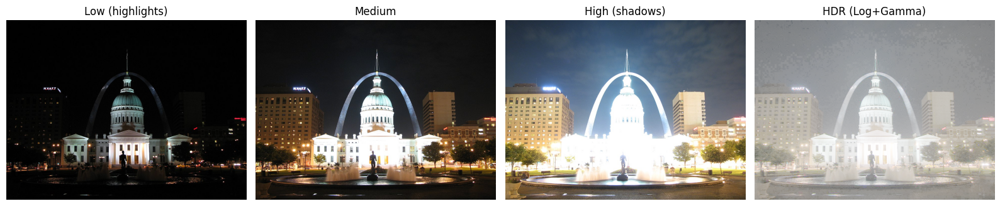

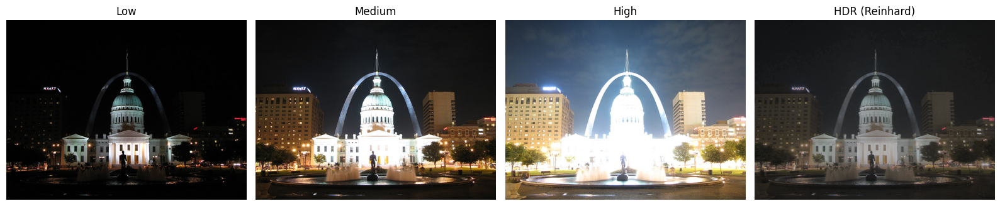

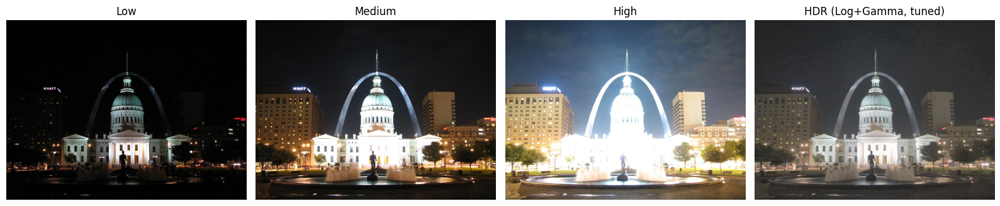

In [13]:
low_p  = '../images/q4/low_exp.png'
med_p  = '../images/q4/med_exp.png'
high_p = '../images/q4/high_exp.png'

if not (os.path.exists(low_p) and os.path.exists(med_p) and os.path.exists(high_p)):
    print("Place low_exp.png, med_exp.png, high_exp.png in images/q4/.")
else:
    low  = imread_color(low_p) #underexposure preserves highlights
    med  = imread_color(med_p) #mid exposure balances the best it could
    high = imread_color(high_p) #and overexposure preserves shadows

    #exposure times(given in assignment spec)
    exposures = [0.25, 2.5, 15.0]  # given in spec
    hdr_lin = hdr_merge([low, med, high], exposures) #merge exposures into HDR images (linear domain)

    #required tone mapping by assignment
    #i.e., logarithmic compression + gamma correction
    tm_log = tone_map_log_gamma(hdr_lin, gamma=2.2)

    #optional Reinhard which i found to be better 
    #tm_rein = tone_map_reinhard(hdr_lin, gamma=2.2)
    #here tuned with γ=1.8 for slightly brighter results
    tm_rein = tone_map_reinhard(hdr_lin, gamma=1.8)

    #to show given exposures + HDR (log+gamma result)
    show_imgs_row(
        [low, med, high, tm_log],
        ["Low (highlights)", "Medium", "High (shadows)", "HDR (Log+Gamma)"],
        figsize=(16,4),
        save_path=os.path.join(OUTPUT_DIR, "q4_hdr_loggamma.png")
    )
    
    #to show given exposures + HDR (reinhard result)
    show_imgs_row(
        [low, med, high, tm_rein],
        ["Low", "Medium", "High", "HDR (Reinhard)"],
        figsize=(16,4),
        save_path=os.path.join(OUTPUT_DIR, "q4_hdr_reinhard.png")
    )

    #logarithmic tone mapping better (let's hope)
    def tone_map_better(hdr_img, gamma=2.2, percentile=99.5):
        x = np.maximum(hdr_img, 0)
        scale = np.percentile(x, percentile) + 1e-6
        x = x / scale
        logc = np.log1p(x)
        logc /= (logc.max() + 1e-6)
        return (np.power(logc, 1.0/gamma) * 255.0).astype(np.float32)

    tm2 = tone_map_better(hdr_lin, gamma=2.2, percentile=99.5)
    show_imgs_row([low, med, high, tm2], ['Low','Medium','High','HDR (Log+Gamma, tuned)'],
                figsize=(16,4),
                save_path=os.path.join(OUTPUT_DIR, 'q4_hdr_loggamma_tuned.png'))  


### Q4 — Observations
- ***Exposure trade-offs***:
    - Low exposure - skies and highlights retain structure, but shadows fall into black.
    - High exposure - shadow detail is revealed nicely now, but still clips the brightest highlights and hides some shadow detail.
    - Medium exposure - overall balance is okay, but still clips the brightest highlights and hides some shadow detail.
- ***HDR Merge***:
    - The merge will pull the highlight details from the Low Exposure image and shadow details from the High Exposure image, this leads to smooth looking transitions (no hard seams), so the weighting is doing its job.
    - Shadow noise is a bit tamer than in the High exposure alone, which is expected after averaging.
- ***Tone Mapping (Log+γ=2.2)***:
    - The plain Log+γ version compresses range but looks flat/gray in the midtones.
    - The tuned Log+γ (with percentile scaling) (implemented in the last) fixed that making blacks cleaner, highlights controlled, and the scene reads more naturally while still following the required pipeline.
    - **γ tweaks** I tried:
        - Lower γ (~1.8) gave brighter shadows, softer contrast.
        - Higher γ (~2.5) gave darker shadows, punchier edges, but easier to re-clip highlights.
- ***Comparision with Reinhard***:
    - Reinhard gave a more “photographic” natural look, while log+γ followed spec and preserved more uniform detail though a little dull.
- ***Limitations***:
    - If exposures are misaligned (camera shake), ghosting may appear — not a problem here since inputs are aligned.
    - If the bracket set is too narrow (e.g., highlights already clipped in the Low), even HDR can’t fully recover them.
    - White-balance mismatches between exposures can cause slight color shifts after merging/tone mapping.
    - More advanced tone mappers (bilateral, local adaptation) can probably give more vivid results.